# Design

# Imports / Global Variables

In [1]:
# Imports

from pprint import pprint
import sys  
sys.path.insert(0, "../src")
from utils import *

# Print parameters

pd.set_option('expand_frame_repr', False)     # print(df) will show all DataFrame columns.
import plotly.io as pio                       # Need this so plotly images in a Jupyter notebook show up in GitHub.
pio.renderers.default="plotly_mimetype"       # "   "

# Default variables - training

data_dir = "../data/flowers"

save_dir = "../src/"
metrics_file_path = os.path.join(save_dir, METRICS_FILE_NAME)
checkpoint_file_path = os.path.join(save_dir, CHECKPOINT_FILE_NAME)

arch = "alexnet"
hidden_units = 250
learning_rate = 0.05
epochs = 30
gpu = True

# Default values - prediction

image_path = "../src/testme.jpg"
categories_file_path = "../data/categories.json"
d_categories = get_categories(categories_file_path)

top_k = 5


# Data Loader

In [2]:
# Get data loaders

dls = get_data_loaders(data_dir)

pprint(dls)

{'test': <torch.utils.data.dataloader.DataLoader object at 0x7f106c3b09d0>,
 'train': <torch.utils.data.dataloader.DataLoader object at 0x7f106c38cbe0>,
 'valid': <torch.utils.data.dataloader.DataLoader object at 0x7f106c3b0880>}


In [ ]:
def print_transforms_grid(dt: ImageFolder,
                          img_index: int,
                          figure_title: str = "Data Processing") -> None:
    """Print grid illustrating image folder transforms on image."""
    
    # Image transforms
    
    trs = dt.transform.transforms
    n_trs = len(trs)
    
    # Original image
    
    rgb_path = dt.samples[img_index][0]
    rgb = Image.open(rgb_path)
    
    # Titles & images for each subplot
    
    subplot_titles = ["Original Image"]
    rgbs = [rgb]
    
    for tr in trs:
        
        subplot_titles.append(tr.__class__.__name__)
        rgbs.append(tr(rgbs[-1]))
        
    # Figure parameters

    n_rows = 1
    n_cols = len(rgbs)
    
    # Create figure    
    
    fig = psub.make_subplots(rows=n_rows, cols=n_cols, subplot_titles = subplot_titles)
    
    for i in range(n_cols):
        
        rgb = rgbs[i]
        if type(rgb) == Tensor:
            rgb = ToPILImage()(rgb)    # Convers tensors to PIL image
        trace = go.Image(z=rgb)
        fig.add_trace(trace, row=1, col=i+1)
    
    fig.layout.title.text = figure_title
        
    fig.show()                        

# Print examples of train / valid / test data processing

img_index = 0

for dt_name in ["train", "valid", "test"]:    
    
    figure_title = "Data Pre-Processing - " + dt_name
    print_transforms_grid(dls[dt_name].dataset, img_index, figure_title)    


# Neural Network

In [4]:
# Load & print untrained neural network

n_categories = len(dls["train"].dataset.classes)
model = get_model(arch, hidden_units, n_categories)
print(model)


AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Linear(in_features=9216, out_features=250, bias=True)
    (1): ReLU()
    (2): Dropout(p=0.5, i

# Training

In [5]:
# Train model

train_model(model, dls, learning_rate, hidden_units, epochs, gpu, metrics_file_path)


learning_rate:  0.050 n_hidden_units:  250 dataset:  train epoch:  0 accuracy:  0.016 loss:  0.148
learning_rate:  0.050 n_hidden_units:  250 dataset:  valid epoch:  0 accuracy:  0.053 loss:  0.142
learning_rate:  0.050 n_hidden_units:  250 dataset:  train epoch:  1 accuracy:  0.018 loss:  0.143
learning_rate:  0.050 n_hidden_units:  250 dataset:  valid epoch:  1 accuracy:  0.055 loss:  0.138
learning_rate:  0.050 n_hidden_units:  250 dataset:  train epoch:  2 accuracy:  0.041 loss:  0.139
learning_rate:  0.050 n_hidden_units:  250 dataset:  valid epoch:  2 accuracy:  0.094 loss:  0.128
learning_rate:  0.050 n_hidden_units:  250 dataset:  train epoch:  3 accuracy:  0.054 loss:  0.134
learning_rate:  0.050 n_hidden_units:  250 dataset:  valid epoch:  3 accuracy:  0.165 loss:  0.119
learning_rate:  0.050 n_hidden_units:  250 dataset:  train epoch:  4 accuracy:  0.072 loss:  0.131
learning_rate:  0.050 n_hidden_units:  250 dataset:  valid epoch:  4 accuracy:  0.199 loss:  0.110
learning_r

In [6]:
# Save Checkpoint
 
save_checkpoint(model,
                dls["valid"].dataset.transform,
                checkpoint_file_path,
                arch,
                hidden_units,
                dls["train"].dataset.class_to_idx)


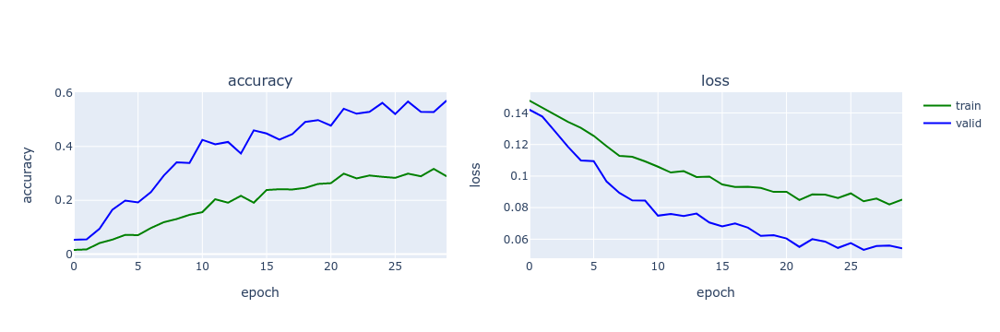

In [7]:
# Plot learning curves

plot_model_learning_curve(metrics_file_path)


# Prediction

In [8]:
# Load Checkpoint

model, tf = load_checkpoint(checkpoint_file_path)

print(model)
print()
print(tf)


AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Linear(in_features=9216, out_features=250, bias=True)
    (1): ReLU()
    (2): Dropout(p=0.5, i

In [9]:
# Predict top k classes

probs_top_k, category_ids_top_k = predict_top_k_categories(image_path, model, tf, top_k, gpu)

print(probs_top_k)
print(category_ids_top_k)                                          


[0.3074096441268921, 0.07868005335330963, 0.05948216840624809, 0.059304382652044296, 0.04462553188204765]
['1', '34', '62', '86', '55']


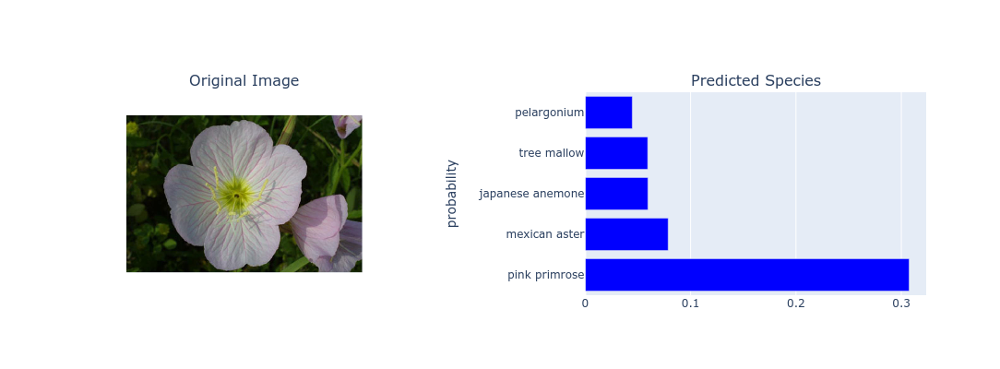

In [10]:
# Plot top k classes   

plot_top_k_categories(image_path, d_categories, probs_top_k, category_ids_top_k)
